<a href="https://colab.research.google.com/github/adammuhtar/ship-detection/blob/main/notebooks/full_notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Convolutional Neural Network (CNN) to Classify Presence of Ships within Satellite Images**

* Name: **Adam Muhtar**


The notebook is run on Python 3.12.9

<ins>**Overview**</ins>

This notebook provides code to train a convolutional neural network for binary classification of aerial satellite images, determining whether a given image contains a ship or not. The network is trained on the [MASATI-v2](https://www.iuii.ua.es/datasets/masati/) dataset.

The full repository can be accessed at: https://github.com/adammuhtar/ship-detection.git

---

## **Table of Contents**

* [1. Notebook setup](#section-1)
* [2. Load MASATI dataset](#section-2)
* [3. Model architecture for Convolutional Neural Network (CNN) models to classify images](#section-3)
* [4. Model training](#section-4)
* [5. Test models on previously unseen image](#section-5)
* [6. Visualise feature maps](#section-6)

## 1. Notebook Setup <a class="anchor" id="section-1"></a>

This notebook uses [Python 3.12.8](https://www.python.org/downloads/release/python-3128/) and requires at minimum the following packages to be installed:
* `ipykernel>=6.29.5`
* `matplotlib>=3.10.0`
* `numpy>=2.2.1`
* `pillow>=11.0.0`
* `torch>=2.5.1`
* `torchvision>=0.20.1`

Refer to either the `pyproject.toml` or `requirements.txt` files in the root directory for the most up-to-date package dependency requirements.

While it is possible to run this notebook on CPUs, it is advisable to run the notebook with hardware accelerators for parallel compute capabilities. We run this notebook on Apple M1 Pro chip with 16GB of RAM. Alternatively, this notebook could also be run using [Google Colab](https://colab.research.google.com/) - Google's implementation of [Jupyter Notebooks](https://jupyter.org/) - which allows users to access Tesla T4 GPU (16 GB GDDR6 @ 320 GB/s) provided for free. At the time of writing, [Google Colab](https://colab.research.google.com/)'s Python version is 3.10.12, which may mean that compatible dependency versions might differ slightly for Colab run notebooks.

In [1]:
# # Uncomment this code block to install the required dependencies
# !pip install --quiet --upgrade ipykernel matplotlib numpy Pillow torch torchvision

In [1]:
# Standard library imports
from pathlib import Path
from time import perf_counter
from typing import Dict, List, Literal, Tuple, Union

# Third party imports
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset, random_split
from torchvision import transforms
from torchvision.utils import make_grid
from tqdm import tqdm

## 2. Load [MASATI-v2](https://www.iuii.ua.es/datasets/masati/) dataset <a class="anchor" id="section-2"></a>

The MASATI-v2 (MAritime SATellite Imagery) is a collection of maritime satellite colour imagery to be used for ship detection research. Created between March and September 2016, the dataset captures maritime scenes from various global regions including Europe, Africa, Asia, and the Atlantic and Pacific Oceans.

Dataset Composition:
- Total Images: 7,389 satellite images (version 2, released in June 2019)
- Image Characteristics:
  - RGB color images from the visible spectrum
  - Average spatial resolution of 512 x 512 pixels
  - Stored in PNG format
  - Captured at varying altitudes and distances

Classification Classes:
1. Images with ships:
   - Ship: 1,027 images of sea with ship(s)
   - Detail: 1,789 detailed images of ship(s)
   - Multi: 304 images with multiple ship(s)
   - Coast & ship: 1,037 images of coasts with ship(s)

2. Images without ships:
   - Sea: 1,022 images of sea without ship(s)
   - Coast: 1,132 images of coasts without ship(s)
   - Land: 1,078 inland images

The dataset attached with this project—available in the [`ship-classifier-cnn`](https://github.com/adammuhtar/ship-classifier-cnn.git) repo—is only a subset of the full dataset (i.e. the first 37 images of each sub-folder) for testing purposes only, to ensure compliance with the 100MB upload limit of the assignment.  We recommend that the unzipped [MASATI-v2](https://www.iuii.ua.es/datasets/masati/) dataset be stored inside the `data` directory for consistency of code.

In [2]:
class MASATIDataset(Dataset):
    """Helper class to load the MASATI-v2 dataset."""
    def __init__(
        self,
        data_dir: Path,
        class_map: Dict[str, List[str]],
        transform: transforms.Compose = None
    ) -> None:
        """
        Initialise the MASATIDataset class.
        
        Args:
            data_dir (`Path`): Pathlib Path to MASATI-v2 directory.
            class_map (`Dict[str, List[str]]`): Maps class names to ship/no-ship
                categories.
            transform (`transforms.Compose`): torchvision transforms to apply to
                images.
        """
        self.data_dir = data_dir
        self.class_map = class_map
        self.transform = transform
        self.image_paths = []
        self.labels = []

        # Dynamically load image paths and labels
        self._load_images()

    def _load_images(self) -> None:
        """
        Load image paths and labels from the MASATI-v2 dataset directory. The
        function iterates over the class_map and assigns a label to each class.
        The image paths and labels are stored in the `image_paths` and `labels`
        lists, respectively.
        """
        for label, class_dirs in enumerate(self.class_map.values()):
            for class_dir in class_dirs:
                class_path = self.data_dir / class_dir
                if class_path.exists() and class_path.is_dir():
                    # Add all image files (.png, .jpg, etc.) to the dataset
                    self.image_paths.extend(class_path.glob("*.png"))
                    self.image_paths.extend(class_path.glob("*.jpg"))
                    self.image_paths.extend(class_path.glob("*.jpeg"))
                    # Assign the current label to each image
                    self.labels.extend([label] * len(list(class_path.glob("*.png"))))
                    self.labels.extend([label] * len(list(class_path.glob("*.jpg"))))
                    self.labels.extend([label] * len(list(class_path.glob("*.jpeg"))))

    def __len__(self) -> int:
        return len(self.image_paths)

    def __getitem__(self, idx) -> Tuple[torch.Tensor, int]:
        # Load image
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert("RGB")
        
        # Apply transformations
        if self.transform:
            image = self.transform(image)
        
        # Get label
        label = self.labels[idx]
        
        return image, label


def show_sample_images(
    dataloader: DataLoader, class_names: List[str], n_images: int = 12
):
    """
    Display a grid of sample images with their labels.
    
    Args:
        dataloader (`DataLoader`): PyTorch DataLoader object containing the
            dataset to visualise.
        class_names (`List[str]`): List of class names.
        n_images (`int`): Number of images to display.
    """
    data_iter = iter(dataloader)
    images, labels = next(data_iter)

    # Create a grid of images
    img_grid = make_grid(images[:n_images], nrow=4)
    plt.figure(figsize=(12, 8))
    plt.imshow(img_grid.permute(1, 2, 0))  # Convert to HWC format for visualisation

    # Add labels as text
    labels_list = [class_names[label] for label in labels[:n_images]]
    for i, label_name in enumerate(labels_list):
        plt.text(
            x=50 + i % 4 * 512,
            y=50 + (i // 4) * 512,
            s=label_name,
            color="white",
            fontsize=8,
            bbox=dict(facecolor="black", alpha=0.7)
        )

    plt.axis("off")
    plt.title("Sample Images with Labels")
    plt.show()

Number of images: 7,389 | Training samples: 5,911 | Validation samples: 1,478
Classes: ['ships', 'no_ships']


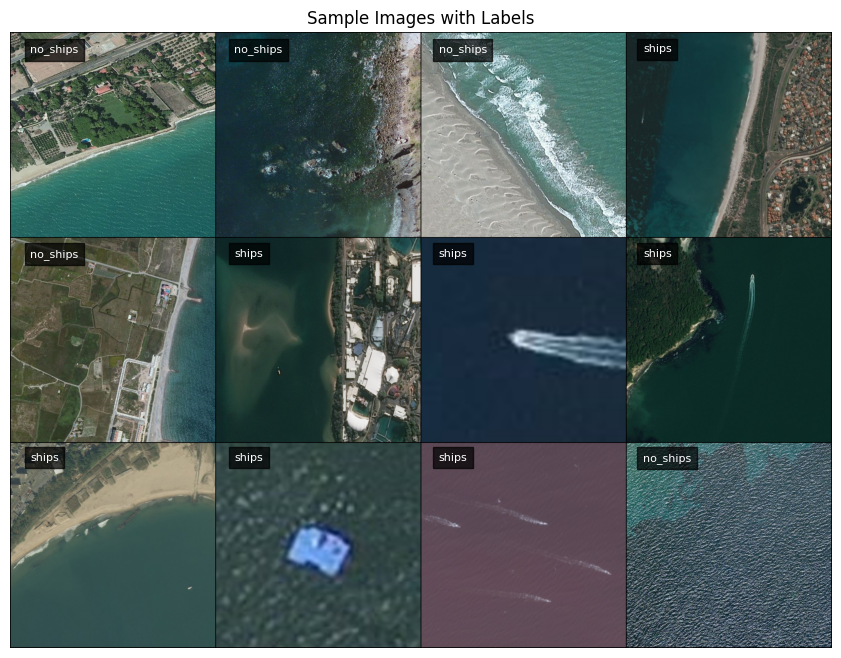

In [3]:
# Set seed for reproducibility
seed = 70103
np.random.seed(seed=seed)
torch.manual_seed(seed=seed)

# Define paths and class mappings (i.e. which MASATI-v2 folders correspond to ship/no-ship classes)
DATA_DIR = Path.cwd().parent / "data" / "MASATI-v2"  # Replace accordingly
CLASS_MAP = {
    "ships": ["coast_ship", "detail", "multi", "ship"],
    "no_ships": ["coast", "land", "water"]
}

# Load the dataset with the defined transformations
dataset = MASATIDataset(
    data_dir=DATA_DIR,
    class_map=CLASS_MAP,
    transform=transforms.Compose(
        [
            transforms.Resize(size=(512, 512)),
            transforms.RandomResizedCrop(size=512, scale=(0.8, 1.0)),
            transforms.RandomHorizontalFlip(),
            transforms.RandomVerticalFlip(),
            transforms.ColorJitter(brightness=0.2, contrast=0.2),
            transforms.ToTensor(),
            transforms.Normalize(
                mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
            )
        ]
    )
)
display_dataset = MASATIDataset(
    data_dir=DATA_DIR,
    class_map=CLASS_MAP,
    transform=transforms.Compose(
        [transforms.Resize(size=(512, 512)), transforms.ToTensor()]
    )
)
# Split the dataset into training and validation sets
train_size = int(0.8 * len(dataset))  # 80% for training
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)
display_data_loader = DataLoader(display_dataset, batch_size=16, shuffle=True)

# Display sample images from the dataset
class_names = list(CLASS_MAP.keys())
print(
    f"Number of images: {len(dataset):,} | "
    f"Training samples: {train_size:,} | "
    f"Validation samples: {val_size:,}"
)
print("Classes:", class_names)
show_sample_images(display_data_loader, class_names)

## 3. Model architecture for Convolutional Neural Network (CNN) models to classify images <a class="anchor" id="section-3"></a>

We define two CNN models, each roughly ~134 million parameters in size:
* `ShipClassifier4ConvNet` with 4 convolutional layers
* `ShipClassifier2ConvNet` with 2 convolutional layers

The model architectures are described in their respective docstrings, with a function to print total trainable parameters for each model.

In [4]:
class ShipClassifier4ConvNet(nn.Module):
    """Convolutional Neural Network for ship classification."""
    def __init__(self, dropout: float = 0.2) -> None:
        """
        Initialise the ShipClassifier4ConvNet class. The model consists of four
        convolutional layers followed by two fully connected layers.
        
        The convolutional layers are as follows:
        - Conv1: 3 input channels (RGB), 32 feature maps, 3x3 kernel, stride 1,
            padding 1
        - Conv2: 32 input channels, 64 feature maps, 3x3 kernel, stride 1,
            padding 1
        - Conv3: 64 input channels, 128 feature maps, 3x3 kernel, stride 1,
            padding 1
        - Conv4: 128 input channels, 256 feature maps, 3x3 kernel, stride 1,
            padding 1
        
        The fully connected layers are as follows:
        - Linear1: 256 * 32 * 32 input features, 512 output features
        - Linear2: 512 input features, 2 output features (ship or no ship)
        
        The ReLU activation function is used after each convolutional and fully
        connected layer, except for the output layer. Max pooling is applied
        after each convolutional layer.
        
        Batch normalisation is applied after each convolutional layer to
        normalise the activations and improve training speed.
        
        Dropout is applied after the first fully connected layer to prevent
        overfitting.
        
        Args:
            dropout (`float`): Dropout probability for the fully connected layer
                to prevent overfitting. Default is 0.2.
        """
        super(ShipClassifier4ConvNet, self).__init__()
        self.conv_layers = nn.Sequential(
            # First convolutional layer
            nn.Conv2d(
                in_channels=3,
                out_channels=32,
                kernel_size=3,
                stride=1,
                padding=1
            ),
            nn.BatchNorm2d(num_features=32),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            
            # Second convolutional layer
            nn.Conv2d(
                in_channels=32,
                out_channels=64,
                kernel_size=3,
                stride=1,
                padding=1
            ),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            
            # Third convolutional layer
            nn.Conv2d(
                in_channels=64,
                out_channels=128,
                kernel_size=3,
                stride=1,
                padding=1
            ),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            
            # Fourth convolutional layer
            nn.Conv2d(
                in_channels=128,
                out_channels=256,
                kernel_size=3,
                stride=1,
                padding=1
            ),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        
        # Fully connected layers
        self.fc_layers = nn.Sequential(
            nn.Flatten(),
            nn.Linear(in_features=(256*32*32), out_features=512),
            nn.ReLU(),
            nn.Dropout(p=dropout),
            nn.Linear(in_features=512, out_features=2)  # Output 2 classes (ship or no ship)
        )

    def forward(self, x):
        x = self.conv_layers(x)
        x = self.fc_layers(x)
        return x

# Function to count total trainable parameters
def count_parameters(model: nn.Module) -> int:
    """
    Count the total number of trainable parameters in a PyTorch model.
    
    Args:
        model (`nn.Module`): PyTorch model.
    
    Returns:
        `int`: Total number of trainable parameters.
    """
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f"Total Trainable Parameters: {count_parameters(ShipClassifier4ConvNet()):,}")
print(ShipClassifier4ConvNet())

Total Trainable Parameters: 134,608,642
ShipClassifier4ConvNet(
  (conv_layers): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU()
    (7): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (8): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU()
    (11): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (12): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(256, eps=1e-

In [5]:
class ShipClassifier2ConvNet(nn.Module):
    """Convolutional Neural Network for ship classification."""
    def __init__(self, dropout: float = 0.2) -> None:
        """
        Initialise the ShipClassifier2ConvNet class. The model consists of four
        convolutional layers followed by two fully connected layers.
        
        The convolutional layers are as follows:
        - Conv1: 3 input channels (RGB), 32 feature maps, 3x3 kernel, stride 1,
            padding 1
        - Conv2: 32 input channels, 64 feature maps, 3x3 kernel, stride 1,
            padding 1
        
        The fully connected layers are as follows:
        - Linear1: 64 * 64 * 64 input features, 512 output features
        - Linear2: 512 input features, 2 output features (ship or no ship)
        
        The ReLU activation function is used after each convolutional and fully
        connected layer, except for the output layer. Max pooling is applied
        after each convolutional layer.
        
        Batch normalisation is applied after each convolutional layer to
        normalise the activations and improve training speed.
        
        Dropout is applied after the first fully connected layer to prevent
        overfitting.
        
        Args:
            dropout (`float`): Dropout probability for the fully connected layer
                to prevent overfitting. Default is 0.2.
        """
        super(ShipClassifier2ConvNet, self).__init__()
        self.conv_layers = nn.Sequential(
            # First convolutional layer
            nn.Conv2d(
                in_channels=3,
                out_channels=32,
                kernel_size=3,
                stride=1,
                padding=1
            ),
            nn.BatchNorm2d(num_features=32),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            
            # Second convolutional layer
            nn.Conv2d(
                in_channels=32,
                out_channels=64,
                kernel_size=3,
                stride=1,
                padding=1
            ),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=4, stride=4)
        )
        
        # Fully connected layers
        self.fc_layers = nn.Sequential(
            nn.Flatten(),
            nn.Linear(in_features=(64*64*64), out_features=512),
            nn.ReLU(),
            nn.Dropout(p=dropout),
            nn.Linear(in_features=512, out_features=2)  # Output 2 classes (ship or no ship)
        )

    def forward(self, x):
        x = self.conv_layers(x)
        x = self.fc_layers(x)
        return x

print(f"Total Trainable Parameters: {count_parameters(ShipClassifier2ConvNet()):,}")
print(ShipClassifier2ConvNet())

Total Trainable Parameters: 134,238,850
ShipClassifier2ConvNet(
  (conv_layers): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU()
    (7): MaxPool2d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  )
  (fc_layers): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): Linear(in_features=262144, out_features=512, bias=True)
    (2): ReLU()
    (3): Dropout(p=0.2, inplace=False)
    (4): Linear(in_features=512, out_features=2, bias=True)
  )
)


## 4. Model training <a class="anchor" id="section-4"></a>

We train both models using a cross-entropy loss function, adaptive moment estimation (Adam) optimiser, and a learning rate scheduler that gradually decreases after 10 epochs.

In [5]:
# Training function
def train_model(
    model: nn.Module,
    train_loader: DataLoader,
    val_loader: DataLoader,
    criterion: nn.Module,
    optimiser: torch.optim.Optimizer,
    scheduler: torch.optim.lr_scheduler.StepLR,
    device: torch.device,
    checkpoint_path: Path,
    num_epochs: int = 30,
    return_losses: bool = True
) -> Union[None, Tuple[List[float], List[float], List[float]]]:
    """
    Train ShipClassifierConvNet models using the specified data loaders, loss
    function, optimiser, and learning rate scheduler.
    
    Args:
        model (`nn.Module`): PyTorch model to train.
        train_loader (`DataLoader`): DataLoader for the training set.
        val_loader (`DataLoader`): DataLoader for the validation set.
        criterion (`nn.Module`): Loss function.
        optimiser (`torch.optim.Optimizer`): Optimizer for training the model.
        scheduler (`torch.optim.lr_scheduler.StepLR`): Learning rate scheduler.
        device (`torch.device`): Device to run the training on (e.g. CPU or GPU).
        checkpoint_path (`Path`): Path to save model checkpoints.
        num_epochs (`int`): Number of epochs to train the model. Default is 30.
        return_losses (`bool`): Return training and validation losse and accuracies.
            Default is True.
    
    Returns:
        `Tuple[List[float], List[float], List[float]]`: Training losses, validation
            losses, and validation accuracies for each epoch if `return_losses`
            is set to True.
    """
    train_losses = []
    val_losses = []
    val_accuracies = []

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        start_time = perf_counter()
        
        # Training loop
        for inputs, labels in tqdm(
            iterable=train_loader,
            desc=f"Epoch {epoch+1}/{num_epochs}",
            unit="batch"
        ):
            inputs, labels = inputs.to(device), labels.to(device)
            
            # Zero gradients, forward pass, calculate loss, backward pass, optimiser step
            optimiser.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimiser.step()

            running_loss += loss.item()
        
        # Average training loss for the epoch
        epoch_train_loss = running_loss / len(train_loader)
        train_losses.append(epoch_train_loss)

        # Validation loop
        model.eval()
        val_running_loss = 0.0
        correct_predictions = 0
        total_samples = 0
        
        # Disable gradient calculations for validation
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                val_running_loss += loss.item()
                
                # Compute accuracy
                _, preds = torch.max(outputs, 1)  # Get predicted class indices
                correct_predictions += torch.sum(preds == labels).item()
                total_samples += labels.size(0)

        epoch_val_loss = val_running_loss / len(val_loader)
        epoch_val_accuracy = correct_predictions / total_samples
        val_losses.append(epoch_val_loss)
        val_accuracies.append(epoch_val_accuracy)

        # Print stats
        elapsed_time = perf_counter() - start_time
        print(
            f"Epoch [{epoch+1}/{num_epochs}] - "
            f"Train Loss: {epoch_train_loss:.4f}, "
            f"Val Loss: {epoch_val_loss:.4f}, "
            f"Val Accuracy: {epoch_val_accuracy:.4f}, "
            f"Time: {elapsed_time:.2f}s"
        )
        
        # Step the scheduler
        scheduler.step()

        # Save checkpoint
        torch.save(
            obj=model.state_dict(),
            f=checkpoint_path / f"ship_classifier_epoch_{epoch+1}.pt"
        )

    # Plot training and validation loss
    plt.figure(figsize=(16, 6))
    
    # Loss plot
    plt.subplot(1, 2, 1)
    plt.plot(range(1, num_epochs + 1), train_losses, label="Train Loss")
    plt.plot(range(1, num_epochs + 1), val_losses, label="Validation Loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Training and Validation Loss")
    plt.legend()
    
    # Accuracy plot
    plt.subplot(1, 2, 2)
    plt.plot(
        range(1, num_epochs + 1),
        val_accuracies,
        label="Validation Accuracy",
        color="green"
    )
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.title("Validation Accuracy")
    plt.legend()
    
    plt.tight_layout()
    plt.show()
    
    if return_losses:
        return train_losses, val_losses, val_accuracies

We first train the `ShipClassifier4ConvNet` model

Epoch 1/30: 100%|██████████| 370/370 [05:06<00:00,  1.21batch/s]


Epoch [1/30] - Train Loss: 0.8835, Val Loss: 0.5131, Val Accuracy: 0.7686, Time: 343.22s


Epoch 2/30: 100%|██████████| 370/370 [05:04<00:00,  1.21batch/s]


Epoch [2/30] - Train Loss: 0.5210, Val Loss: 0.5096, Val Accuracy: 0.7835, Time: 341.60s


Epoch 3/30: 100%|██████████| 370/370 [05:06<00:00,  1.21batch/s]


Epoch [3/30] - Train Loss: 0.5054, Val Loss: 0.5024, Val Accuracy: 0.7821, Time: 343.26s


Epoch 4/30: 100%|██████████| 370/370 [05:03<00:00,  1.22batch/s]


Epoch [4/30] - Train Loss: 0.5023, Val Loss: 0.4926, Val Accuracy: 0.7957, Time: 341.31s


Epoch 5/30: 100%|██████████| 370/370 [05:02<00:00,  1.22batch/s]


Epoch [5/30] - Train Loss: 0.4962, Val Loss: 0.4805, Val Accuracy: 0.7977, Time: 339.88s


Epoch 6/30: 100%|██████████| 370/370 [05:05<00:00,  1.21batch/s]


Epoch [6/30] - Train Loss: 0.4922, Val Loss: 0.4856, Val Accuracy: 0.7923, Time: 343.43s


Epoch 7/30: 100%|██████████| 370/370 [05:05<00:00,  1.21batch/s]


Epoch [7/30] - Train Loss: 0.4866, Val Loss: 0.4869, Val Accuracy: 0.8018, Time: 343.12s


Epoch 8/30: 100%|██████████| 370/370 [05:05<00:00,  1.21batch/s]


Epoch [8/30] - Train Loss: 0.4862, Val Loss: 0.4756, Val Accuracy: 0.8058, Time: 343.17s


Epoch 9/30: 100%|██████████| 370/370 [05:03<00:00,  1.22batch/s]


Epoch [9/30] - Train Loss: 0.4804, Val Loss: 0.4765, Val Accuracy: 0.8024, Time: 340.11s


Epoch 10/30: 100%|██████████| 370/370 [05:05<00:00,  1.21batch/s]


Epoch [10/30] - Train Loss: 0.4815, Val Loss: 0.4895, Val Accuracy: 0.7936, Time: 341.88s


Epoch 11/30: 100%|██████████| 370/370 [05:01<00:00,  1.23batch/s]


Epoch [11/30] - Train Loss: 0.4600, Val Loss: 0.4581, Val Accuracy: 0.8234, Time: 339.96s


Epoch 12/30: 100%|██████████| 370/370 [05:04<00:00,  1.22batch/s]


Epoch [12/30] - Train Loss: 0.4525, Val Loss: 0.4469, Val Accuracy: 0.8200, Time: 341.39s


Epoch 13/30: 100%|██████████| 370/370 [05:05<00:00,  1.21batch/s]


Epoch [13/30] - Train Loss: 0.4560, Val Loss: 0.4515, Val Accuracy: 0.8248, Time: 341.39s


Epoch 14/30: 100%|██████████| 370/370 [05:05<00:00,  1.21batch/s]


Epoch [14/30] - Train Loss: 0.4488, Val Loss: 0.4576, Val Accuracy: 0.8173, Time: 343.86s


Epoch 15/30: 100%|██████████| 370/370 [05:15<00:00,  1.17batch/s]


Epoch [15/30] - Train Loss: 0.4505, Val Loss: 0.4489, Val Accuracy: 0.8166, Time: 356.17s


Epoch 16/30: 100%|██████████| 370/370 [05:17<00:00,  1.17batch/s]


Epoch [16/30] - Train Loss: 0.4433, Val Loss: 0.4450, Val Accuracy: 0.8234, Time: 355.66s


Epoch 17/30: 100%|██████████| 370/370 [05:09<00:00,  1.19batch/s]


Epoch [17/30] - Train Loss: 0.4441, Val Loss: 0.4417, Val Accuracy: 0.8248, Time: 347.18s


Epoch 18/30: 100%|██████████| 370/370 [05:07<00:00,  1.21batch/s]


Epoch [18/30] - Train Loss: 0.4428, Val Loss: 0.4501, Val Accuracy: 0.8241, Time: 345.54s


Epoch 19/30: 100%|██████████| 370/370 [05:10<00:00,  1.19batch/s]


Epoch [19/30] - Train Loss: 0.4447, Val Loss: 0.4454, Val Accuracy: 0.8268, Time: 348.69s


Epoch 20/30: 100%|██████████| 370/370 [05:10<00:00,  1.19batch/s]


Epoch [20/30] - Train Loss: 0.4401, Val Loss: 0.4395, Val Accuracy: 0.8295, Time: 347.51s


Epoch 21/30: 100%|██████████| 370/370 [05:09<00:00,  1.20batch/s]


Epoch [21/30] - Train Loss: 0.4372, Val Loss: 0.4440, Val Accuracy: 0.8227, Time: 347.13s


Epoch 22/30: 100%|██████████| 370/370 [05:14<00:00,  1.18batch/s]


Epoch [22/30] - Train Loss: 0.4352, Val Loss: 0.4398, Val Accuracy: 0.8275, Time: 353.87s


Epoch 23/30: 100%|██████████| 370/370 [05:12<00:00,  1.18batch/s]


Epoch [23/30] - Train Loss: 0.4358, Val Loss: 0.4406, Val Accuracy: 0.8309, Time: 352.13s


Epoch 24/30: 100%|██████████| 370/370 [05:18<00:00,  1.16batch/s]


Epoch [24/30] - Train Loss: 0.4330, Val Loss: 0.4415, Val Accuracy: 0.8227, Time: 355.66s


Epoch 25/30: 100%|██████████| 370/370 [05:08<00:00,  1.20batch/s]


Epoch [25/30] - Train Loss: 0.4366, Val Loss: 0.4339, Val Accuracy: 0.8356, Time: 346.60s


Epoch 26/30: 100%|██████████| 370/370 [05:05<00:00,  1.21batch/s]


Epoch [26/30] - Train Loss: 0.4363, Val Loss: 0.4409, Val Accuracy: 0.8315, Time: 342.25s


Epoch 27/30: 100%|██████████| 370/370 [05:10<00:00,  1.19batch/s]


Epoch [27/30] - Train Loss: 0.4351, Val Loss: 0.4417, Val Accuracy: 0.8336, Time: 348.11s


Epoch 28/30: 100%|██████████| 370/370 [05:08<00:00,  1.20batch/s]


Epoch [28/30] - Train Loss: 0.4391, Val Loss: 0.4450, Val Accuracy: 0.8234, Time: 346.20s


Epoch 29/30: 100%|██████████| 370/370 [05:09<00:00,  1.19batch/s]


Epoch [29/30] - Train Loss: 0.4360, Val Loss: 0.4381, Val Accuracy: 0.8261, Time: 347.12s


Epoch 30/30: 100%|██████████| 370/370 [05:02<00:00,  1.22batch/s]


Epoch [30/30] - Train Loss: 0.4333, Val Loss: 0.4357, Val Accuracy: 0.8295, Time: 338.72s


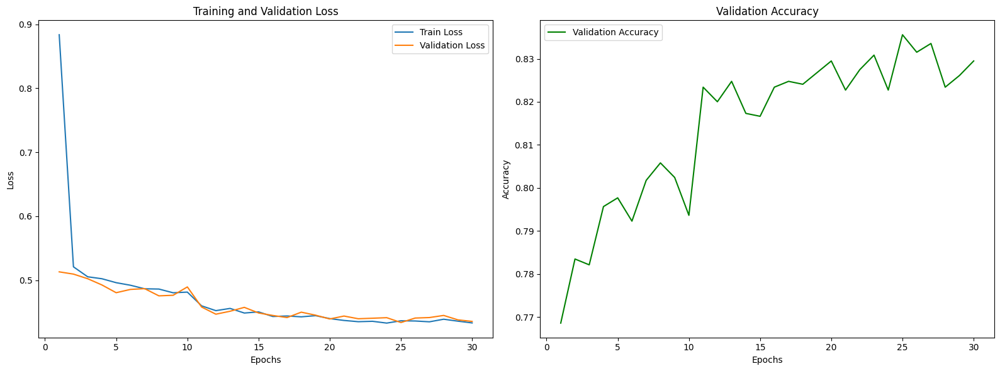

In [6]:
# Set the device to GPU if available, otherwise use the CPU
device = torch.device(
    "cuda" if torch.cuda.is_available()
    else "mps" if torch.backends.mps.is_built()
    else "cpu"
)

# Initialise the model, loss function, optimiser, and learning rate scheduler
model = ShipClassifier4ConvNet(dropout=0.2).to(device)
criterion = nn.CrossEntropyLoss(label_smoothing=0.1)
optimiser = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.StepLR(optimiser, step_size=10, gamma=0.1)

# Directory for saving models
model_checkpoint_path = Path.cwd().parent / "model_checkpoints"
if not model_checkpoint_path.exists():
    model_checkpoint_path.mkdir(parents=True, exist_ok=True)

# Train the model
num_epochs = 30
train_losses, val_losses, val_accuracies = train_model(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    criterion=criterion,
    optimiser=optimiser,
    scheduler=scheduler,
    device=device,
    checkpoint_path=model_checkpoint_path,
    num_epochs=num_epochs
)

Next, we train the `ShipClassifier2ConvNet` model

Epoch 1/30: 100%|██████████| 370/370 [04:25<00:00,  1.39batch/s]


Epoch [1/30] - Train Loss: 1.2614, Val Loss: 0.5374, Val Accuracy: 0.7666, Time: 300.39s


Epoch 2/30: 100%|██████████| 370/370 [04:35<00:00,  1.34batch/s]


Epoch [2/30] - Train Loss: 0.5384, Val Loss: 0.5158, Val Accuracy: 0.7835, Time: 309.63s


Epoch 3/30: 100%|██████████| 370/370 [04:33<00:00,  1.35batch/s]


Epoch [3/30] - Train Loss: 0.5291, Val Loss: 0.5231, Val Accuracy: 0.7903, Time: 307.15s


Epoch 4/30: 100%|██████████| 370/370 [04:29<00:00,  1.37batch/s]


Epoch [4/30] - Train Loss: 0.5214, Val Loss: 0.4973, Val Accuracy: 0.7943, Time: 303.69s


Epoch 5/30: 100%|██████████| 370/370 [04:31<00:00,  1.36batch/s]


Epoch [5/30] - Train Loss: 0.5108, Val Loss: 0.5041, Val Accuracy: 0.7876, Time: 305.78s


Epoch 6/30: 100%|██████████| 370/370 [04:30<00:00,  1.37batch/s]


Epoch [6/30] - Train Loss: 0.5137, Val Loss: 0.4973, Val Accuracy: 0.7923, Time: 305.16s


Epoch 7/30: 100%|██████████| 370/370 [04:30<00:00,  1.37batch/s]


Epoch [7/30] - Train Loss: 0.5058, Val Loss: 0.5082, Val Accuracy: 0.7767, Time: 304.98s


Epoch 8/30: 100%|██████████| 370/370 [04:26<00:00,  1.39batch/s]


Epoch [8/30] - Train Loss: 0.5019, Val Loss: 0.4829, Val Accuracy: 0.8011, Time: 300.40s


Epoch 9/30: 100%|██████████| 370/370 [04:31<00:00,  1.36batch/s]


Epoch [9/30] - Train Loss: 0.5013, Val Loss: 0.5021, Val Accuracy: 0.7801, Time: 305.49s


Epoch 10/30: 100%|██████████| 370/370 [04:31<00:00,  1.36batch/s]


Epoch [10/30] - Train Loss: 0.4931, Val Loss: 0.4936, Val Accuracy: 0.7936, Time: 305.06s


Epoch 11/30: 100%|██████████| 370/370 [04:32<00:00,  1.36batch/s]


Epoch [11/30] - Train Loss: 0.4799, Val Loss: 0.4682, Val Accuracy: 0.8139, Time: 306.00s


Epoch 12/30: 100%|██████████| 370/370 [04:36<00:00,  1.34batch/s]


Epoch [12/30] - Train Loss: 0.4770, Val Loss: 0.4677, Val Accuracy: 0.8038, Time: 312.18s


Epoch 13/30: 100%|██████████| 370/370 [04:37<00:00,  1.34batch/s]


Epoch [13/30] - Train Loss: 0.4771, Val Loss: 0.4702, Val Accuracy: 0.8112, Time: 312.88s


Epoch 14/30: 100%|██████████| 370/370 [04:35<00:00,  1.34batch/s]


Epoch [14/30] - Train Loss: 0.4761, Val Loss: 0.4684, Val Accuracy: 0.8139, Time: 309.82s


Epoch 15/30: 100%|██████████| 370/370 [04:34<00:00,  1.35batch/s]


Epoch [15/30] - Train Loss: 0.4745, Val Loss: 0.4677, Val Accuracy: 0.8180, Time: 310.91s


Epoch 16/30: 100%|██████████| 370/370 [04:38<00:00,  1.33batch/s]


Epoch [16/30] - Train Loss: 0.4776, Val Loss: 0.4708, Val Accuracy: 0.8160, Time: 313.62s


Epoch 17/30: 100%|██████████| 370/370 [04:41<00:00,  1.31batch/s]


Epoch [17/30] - Train Loss: 0.4728, Val Loss: 0.4677, Val Accuracy: 0.8139, Time: 318.09s


Epoch 18/30: 100%|██████████| 370/370 [04:46<00:00,  1.29batch/s]


Epoch [18/30] - Train Loss: 0.4740, Val Loss: 0.4632, Val Accuracy: 0.8194, Time: 323.52s


Epoch 19/30: 100%|██████████| 370/370 [04:42<00:00,  1.31batch/s]


Epoch [19/30] - Train Loss: 0.4712, Val Loss: 0.4667, Val Accuracy: 0.8207, Time: 320.44s


Epoch 20/30: 100%|██████████| 370/370 [04:43<00:00,  1.30batch/s]


Epoch [20/30] - Train Loss: 0.4678, Val Loss: 0.4644, Val Accuracy: 0.8221, Time: 318.93s


Epoch 21/30: 100%|██████████| 370/370 [04:34<00:00,  1.35batch/s]


Epoch [21/30] - Train Loss: 0.4707, Val Loss: 0.4647, Val Accuracy: 0.8194, Time: 308.59s


Epoch 22/30: 100%|██████████| 370/370 [04:34<00:00,  1.35batch/s]


Epoch [22/30] - Train Loss: 0.4693, Val Loss: 0.4649, Val Accuracy: 0.8106, Time: 309.14s


Epoch 23/30: 100%|██████████| 370/370 [04:40<00:00,  1.32batch/s]


Epoch [23/30] - Train Loss: 0.4648, Val Loss: 0.4646, Val Accuracy: 0.8146, Time: 316.82s


Epoch 24/30: 100%|██████████| 370/370 [04:40<00:00,  1.32batch/s]


Epoch [24/30] - Train Loss: 0.4658, Val Loss: 0.4655, Val Accuracy: 0.8153, Time: 315.70s


Epoch 25/30: 100%|██████████| 370/370 [04:39<00:00,  1.32batch/s]


Epoch [25/30] - Train Loss: 0.4719, Val Loss: 0.4681, Val Accuracy: 0.8119, Time: 315.23s


Epoch 26/30: 100%|██████████| 370/370 [04:38<00:00,  1.33batch/s]


Epoch [26/30] - Train Loss: 0.4678, Val Loss: 0.4628, Val Accuracy: 0.8160, Time: 314.32s


Epoch 27/30: 100%|██████████| 370/370 [04:40<00:00,  1.32batch/s]


Epoch [27/30] - Train Loss: 0.4654, Val Loss: 0.4630, Val Accuracy: 0.8146, Time: 315.10s


Epoch 28/30: 100%|██████████| 370/370 [04:37<00:00,  1.33batch/s]


Epoch [28/30] - Train Loss: 0.4706, Val Loss: 0.4650, Val Accuracy: 0.8146, Time: 312.51s


Epoch 29/30: 100%|██████████| 370/370 [04:36<00:00,  1.34batch/s]


Epoch [29/30] - Train Loss: 0.4672, Val Loss: 0.4657, Val Accuracy: 0.8126, Time: 311.61s


Epoch 30/30: 100%|██████████| 370/370 [04:37<00:00,  1.33batch/s]


Epoch [30/30] - Train Loss: 0.4693, Val Loss: 0.4643, Val Accuracy: 0.8139, Time: 313.58s


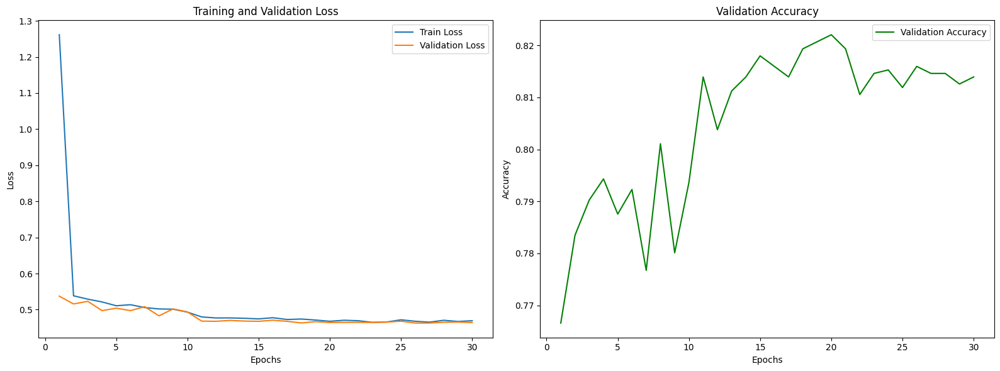

In [ ]:
# Set the device to GPU if available, otherwise use the CPU
device = torch.device(
    "cuda" if torch.cuda.is_available()
    else "mps" if torch.backends.mps.is_built()
    else "cpu"
)

# Initialise the model, loss function, optimiser, and learning rate scheduler
model = ShipClassifier2ConvNet(dropout=0.2).to(device)
criterion = nn.CrossEntropyLoss(label_smoothing=0.1)
optimiser = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.StepLR(optimiser, step_size=10, gamma=0.1)

# Directory for saving models
model_checkpoint_path = Path.cwd().parent / "model_checkpoints"
if not model_checkpoint_path.exists():
    model_checkpoint_path.mkdir(parents=True, exist_ok=True)

# Train the model
num_epochs = 30
train_losses, val_losses, val_accuracies = train_model(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    criterion=criterion,
    optimiser=optimiser,
    scheduler=scheduler,
    device=device,
    checkpoint_path=model_checkpoint_path,
    num_epochs=num_epochs
)

## 5. Test models on previously unseen image <a class="anchor" id="section-5"></a>

We test the models on the image below, which is a satellite image of the San Francisco Bay from [Hammell (2018)](https://www.kaggle.com/datasets/rhammell/ships-in-satellite-imagery). We observe that both models got the classifications correct, although `ShipClassifier4ConvNet` registers a higher confidence score.

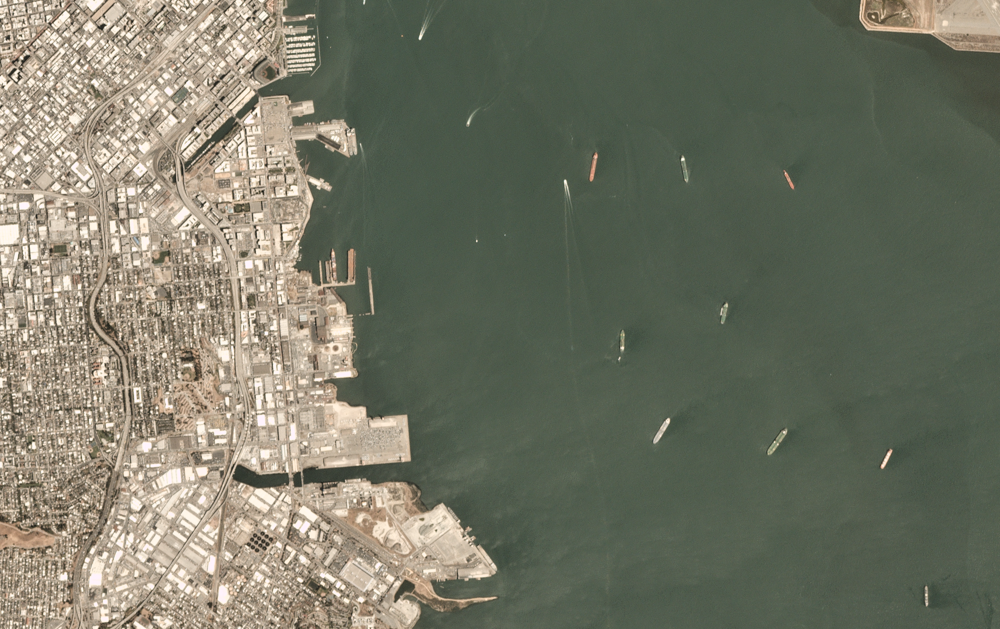

In [6]:
# Display test image
test_image_path = Path.cwd().parent / "data" / "sfbay_1.png"
test_image = Image.open(test_image_path)
display(test_image)

In [6]:
def preprocess_image(
    image_path: Union[str, Path],
    target_size: tuple = (512, 512),
    device: Literal["cpu", "cuda", "mps"] = "mps"
) -> torch.Tensor:
    """
    Preprocess an image for inference with a PyTorch model.
    
    Args:
        image_path (`str` or `Path`): Path to the image file.
        target_size (`tuple`): Target size for resizing the image. Default is
            (512, 512).
        device (`"cpu"`, `"cuda"` or `"mps"` only): Device to run the inference on.
            Default is "mps".
    
    Returns:
        `torch.Tensor`: Preprocessed image tensor.
    """
    # Load the image
    image = Image.open(image_path).convert("RGB")

    # Resize the image
    transform = transforms.Compose(
        [
            transforms.Resize(size=target_size),
            transforms.ToTensor(),
            transforms.Normalize(
                    mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
                )
        ]
    )
    return transform(image).unsqueeze(0).to(device)

def run_inference(
    model: nn.Module,
    image_path: Union[str, Path],
    class_names: List,
    device: Literal["cpu", "cuda", "mps"] = "mps"
) -> Tuple[str, float]:
    """
    Run inference on an image using a PyTorch model.
    
    Args:
        model (`nn.Module`): PyTorch model for inference.
        image_path (`str` or `Path`): Path to the image file.
        class_names (`List`): List of class names.
        device (`"cpu"`, `"cuda"` or `"mps"` only): Device to run the inference
            on. Default is "mps".
    
    Returns:
        `Tuple[str, float]`: Predicted class and confidence score.
    """
    # Preprocess the image
    image_tensor = preprocess_image(image_path, device=device)

    with torch.no_grad():
        # Set the model to evaluation mode
        model.eval()
        
        # Perform forward pass to get model outputs
        outputs = model(image_tensor)
        
        # Get predicted class by finding the index with the maximum score
        _, predicted = torch.max(outputs, 1)
        
        # Calculate confidence scores using softmax and convert to percentage
        confidence = torch.nn.functional.softmax(outputs, dim=1)[0] * 100
        
        # Map predicted class index to the class name
        predicted_class = class_names[predicted.item()]
    
    return predicted_class, confidence

In [7]:
# Path to the saved checkpoint
path_4convnet = Path.cwd().parent / "model_checkpoints_4conv" / "ship_classifier_epoch_25.pt"
path_2convnet = Path.cwd().parent / "model_checkpoints_2conv" / "ship_classifier_epoch_26.pt"

# Set the device to GPU if available, otherwise use the CPU
device = torch.device(
    "cuda" if torch.cuda.is_available()
    else "mps" if torch.backends.mps.is_built()
    else "cpu"
)

# Load the model and set to evaluation mode
model_4convnet = ShipClassifier4ConvNet().to(device)
model_2convnet = ShipClassifier2ConvNet().to(device)
model_4convnet.load_state_dict(
    state_dict=torch.load(
        f=path_4convnet, map_location=device, weights_only=True
    )
)
model_2convnet.load_state_dict(
    state_dict=torch.load(
        f=path_2convnet, map_location=device, weights_only=True
    )
)

# Run inference on the test image using ShipClassifier4ConvNet
test_image_path = Path.cwd().parent / "data" / "MASATI-v2-100mb" / "sfbay_1.png"
predicted_class, confidence = run_inference(
    model=model_4convnet,
    image_path=test_image_path,
    class_names=list(reversed(CLASS_MAP.keys()))
)
print("="*40)
print(f"Model: ShipClassifier4ConvNet")
print(f"Predicted Class: {predicted_class.capitalize()}")
print(f"Confidence: Ship: {confidence[1].item():.2f}% | No Ship: {confidence[0].item():.2f}%")
print("-"*40)

# Run inference on the test image using ShipClassifier2ConvNet
predicted_class, confidence = run_inference(
    model=model_2convnet,
    image_path=test_image_path,
    class_names=list(reversed(CLASS_MAP.keys()))
)
print(f"Model: ShipClassifier2ConvNet")
print(f"Predicted Class: {predicted_class.capitalize()}")
print(f"Confidence: Ship: {confidence[1].item():.2f}% | No Ship: {confidence[0].item():.2f}%")
print("="*40)

Model: ShipClassifier4ConvNet
Predicted Class: Ships
Confidence: Ship: 80.29% | No Ship: 19.71%
----------------------------------------
Model: ShipClassifier2ConvNet
Predicted Class: Ships
Confidence: Ship: 70.98% | No Ship: 29.02%


## 6. Visualise feature maps <a class="anchor" id="section-6"></a>

Visualising feature maps involves capturing the intermediate outputs of a convolutional layer in a neural network as an input image passes through the model. A forward hook function is attached to the desired layer to intercept and store its output (feature maps), which represent the learned features at that stage. These feature maps are then plotted to reveal patterns or activations that the layer emphasises.

Feature maps of 1st convolutional layer of ShipClassifier4ConvNet


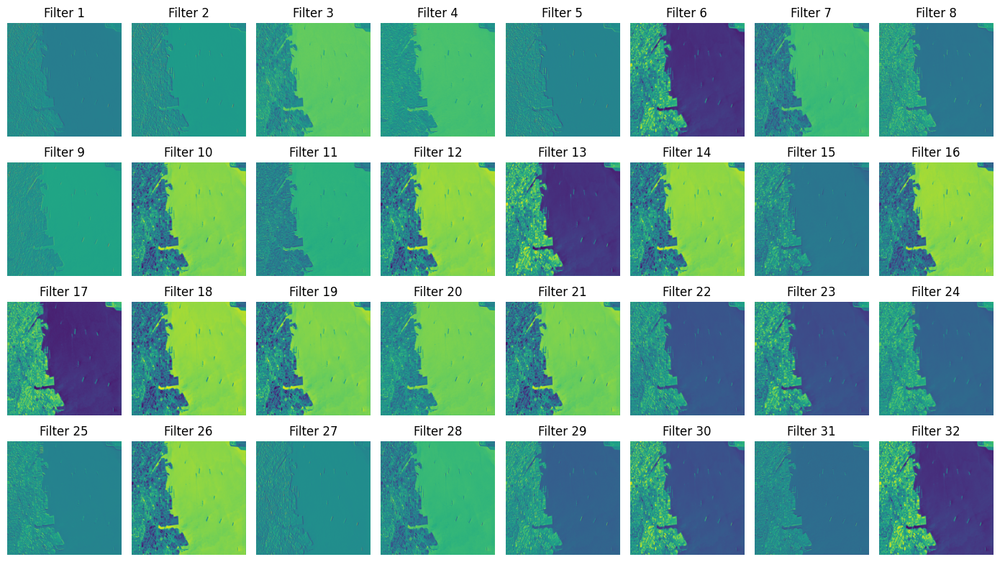

In [8]:
def visualise_feature_maps(
    model: nn.Module,
    image_path: Union[str, Path],
    layer_name: int = 0,
    device: Literal["cpu", "cuda", "mps"] = "mps",
    fig_size: Tuple[int, int] = (14, 8)
) -> None:
    """
    Visualise feature maps produced by a specified convolutional layer.

    Args:
        model (`nn.Module`): The model to visualize.
        image_path (`str` or `Path`): Path to the input image.
        layer_name (`int`): Name of the layer to visualise. 0 is the first
            convolutional layer, 1 is the second convolutional layer, and so on.
            Default is 0.
        device (`str`): Torch device to use. Default is "mps".
        fig_size (`Tuple[int, int]`): Plot figure size. Default is (14, 8).
    """
    # Ensure the model is in evaluation mode
    model.eval()
    model.to(device)
    
    # Hook to capture feature maps
    feature_maps = None
    def hook_fn(
        module: nn.Module, input: tuple[torch.Tensor], output: torch.Tensor
    ) -> None:
        """
        Hook function to capture the output (feature maps) of a layer during a
        forward pass. Used as a forward hook to intercept the output of a specific
        layer in a neural network. The output (feature maps) is detached from the
        computation graph and stored in a nonlocal variable for later analysis.

        Args:
            module (`nn.Module`): The layer module from which the hook captures
                the output.
            input (`tuple[torch.Tensor]`): The input tensor(s) to the layer. This
                includes any tensors passed to the layer during the forward pass.
            output (`torch.Tensor`): The output tensor of the layer. This is the
                feature map produced by the layer during the forward pass.

        Returns:
            `None`: It updates the nonlocal `feature_maps` variable to store the
                layer's output.
        
        Reference:
            https://www.digitalocean.com/community/tutorials/pytorch-hooks-gradient-clipping-debugging
        """
        # Use nonlocal to update external feature_maps variable
        nonlocal feature_maps

        # Detach output from computation graph to avoid modifying the model's gradients
        feature_maps = output.detach()

    # Register hook for the specified layer
    for name, layer in model.named_modules():
        if str(layer_name) in name:
            layer.register_forward_hook(hook_fn)
            break
    else:
        raise ValueError(f"Layer '{layer_name}' not found in model.")
    
    # Forward pass to capture feature maps
    with torch.no_grad():
        _ = model(preprocess_image(image_path, device=device))
    
    # Move feature maps to CPU for visualisation
    feature_maps = feature_maps.cpu().squeeze(0)
    
    # Plot feature maps
    num_feature_maps = feature_maps.size(0)
    cols = 8
    rows = (num_feature_maps + cols - 1) // cols  # Compute rows dynamically
    
    plt.figure(figsize=fig_size)
    for i in range(num_feature_maps):
        plt.subplot(rows, cols, i + 1)
        plt.imshow(feature_maps[i].numpy(), cmap="viridis")
        plt.axis("off")
        plt.title(f"Filter {i + 1}")
    plt.tight_layout()
    plt.show()

# Visualise feature maps from first convolutional layer of ShipClassifier4ConvNet
print("Feature maps of 1st convolutional layer of ShipClassifier4ConvNet")
visualise_feature_maps(model_4convnet, test_image_path, layer_name=0)

Feature maps of 1st convolutional layer of ShipClassifier2ConvNet


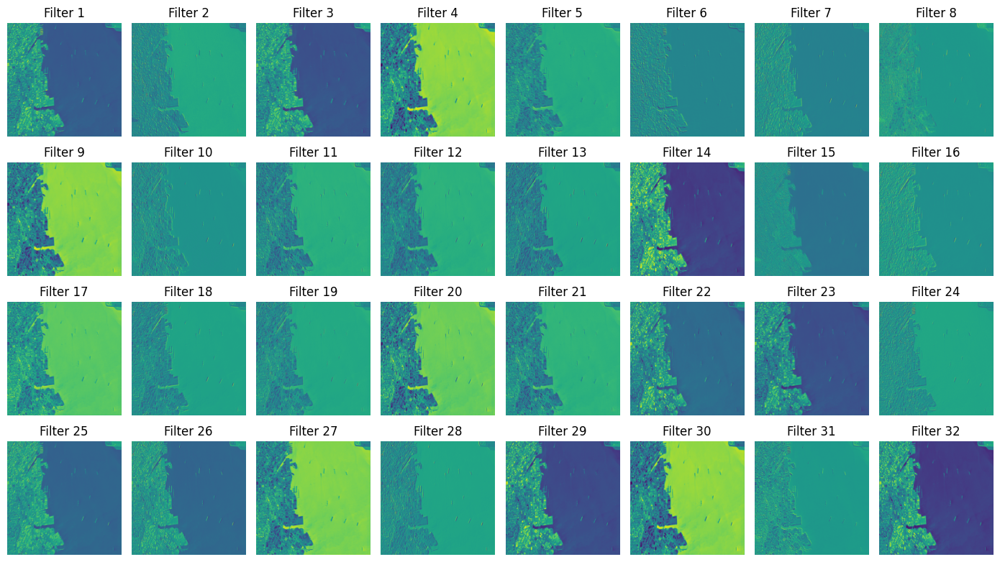

In [9]:
# Visualise feature maps from first convolutional layer of ShipClassifier4ConvNet
print("Feature maps of 1st convolutional layer of ShipClassifier2ConvNet")
visualise_feature_maps(model_2convnet, test_image_path, layer_name=0)

Feature maps of 2nd convolutional layer of ShipClassifier4ConvNet


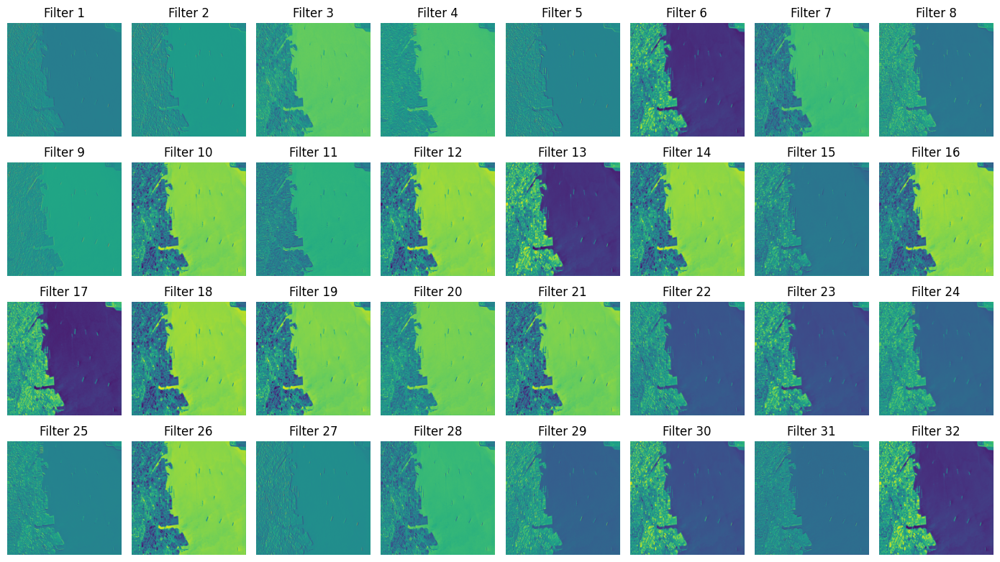

In [10]:
# Visualise feature maps from first convolutional layer of ShipClassifier4ConvNet
print("Feature maps of 2nd convolutional layer of ShipClassifier4ConvNet")
visualise_feature_maps(model_4convnet, test_image_path, layer_name=1)

Feature maps of 2nd convolutional layer of ShipClassifier2ConvNet


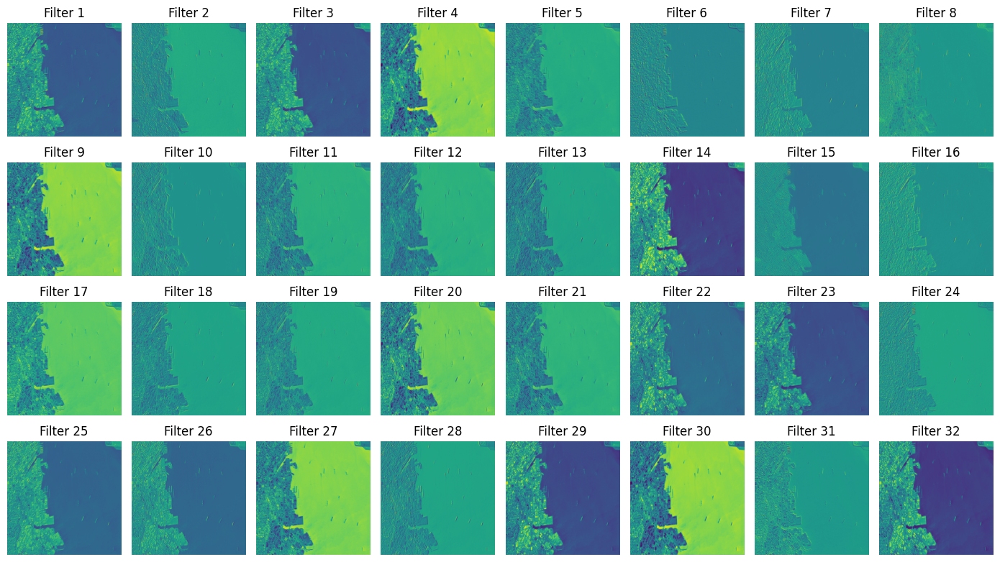

In [11]:
# Visualise feature maps from first convolutional layer of ShipClassifier4ConvNet
print("Feature maps of 2nd convolutional layer of ShipClassifier2ConvNet")
visualise_feature_maps(model_2convnet, test_image_path, layer_name=1)

Feature maps of 3rd convolutional layer of ShipClassifier4ConvNet


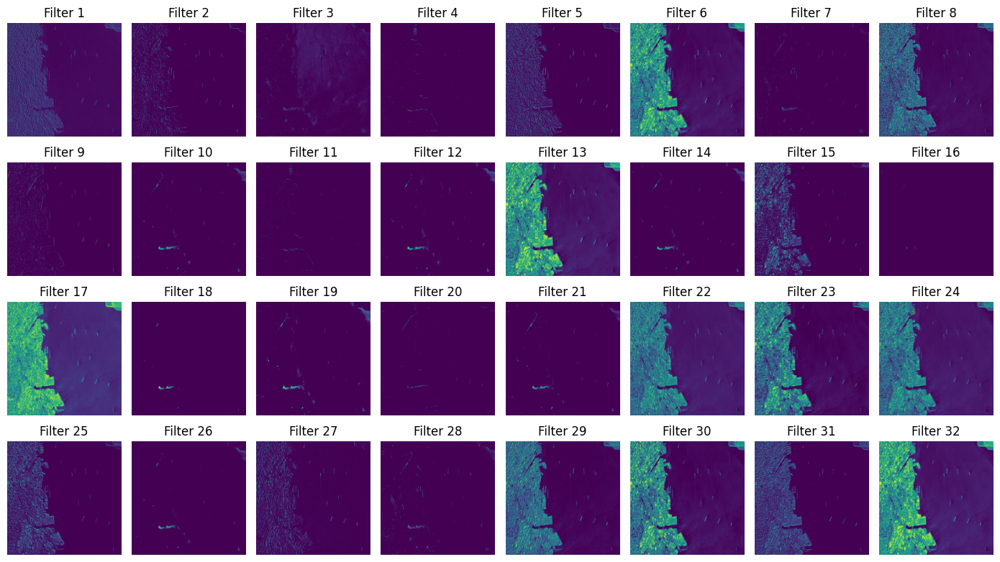

In [12]:
# Visualise feature maps from first convolutional layer of ShipClassifier4ConvNet
print("Feature maps of 3rd convolutional layer of ShipClassifier4ConvNet")
visualise_feature_maps(model_4convnet, test_image_path, layer_name=2)

Feature maps of 4th convolutional layer of ShipClassifier4ConvNet


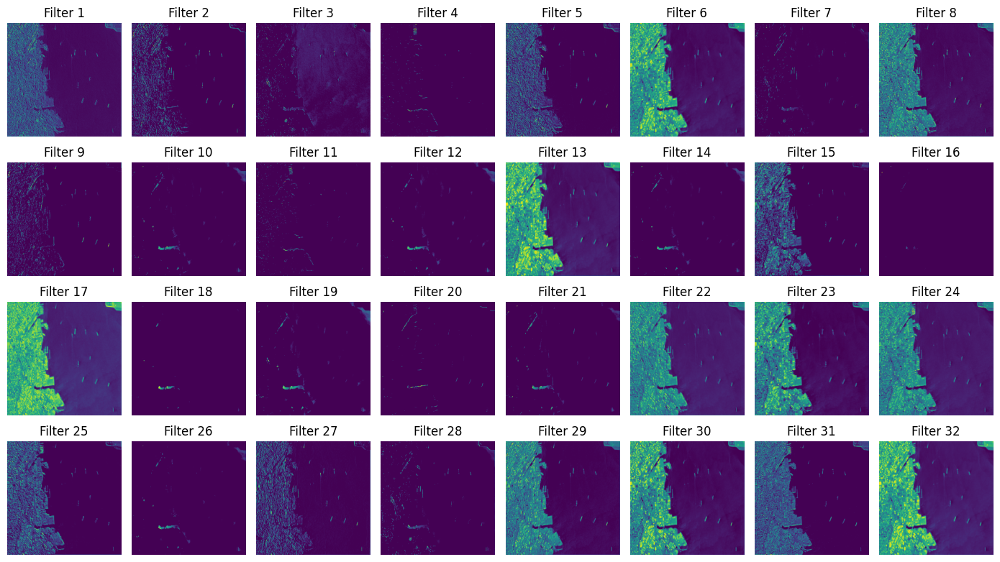

In [13]:
# Visualise feature maps from first convolutional layer of ShipClassifier4ConvNet
print("Feature maps of 4th convolutional layer of ShipClassifier4ConvNet")
visualise_feature_maps(model_4convnet, test_image_path, layer_name=3)